In [1]:
!pip install fbm


[notice] A new release of pip is available: 24.0 -> 24.2
[notice] To update, run: pip install --upgrade pip


In [2]:
import sys
PATH_TO_SITE_PACKAGES = 'C:\\Users\\DM6579\\Anaconda3\\envs\\SmileHJM\\Lib\\site-packages'
if PATH_TO_SITE_PACKAGES not in sys.path:
    sys.path.append(PATH_TO_SITE_PACKAGES)

In [5]:
%load_ext autoreload
%autoreload 2
import sys
if ".." not in sys.path:
    sys.path.append("..")

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.graphics.tsaplots import plot_acf
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go
from fbm import FBM
from scipy.stats import norm
from sklearn.linear_model import LinearRegression
from tqdm.auto import tqdm
from scipy.optimize import root_scalar

from roughness.stochastic_volatility import price_from_volatility
from roughness.realized_volatility import realized_volatility
from roughness.simulation import *
from roughness.hurst_estimation import m_estimator

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [4]:
def roughness_report(vol_traj):
    print("m-estimator:", m_estimator(np.log(vol_traj), is_plotting=False, intersect=True))

# Part 1. Fractional Brownian Motion

__Fractional brownian motion__ (fBM) with Hurst parameter $H \in (0,\, 1)$:
1. Gaussian process
2. $\mathbb{E}|W_{t+\Delta}^H - W_t^H|^q = K_q\Delta^{qH}$.

In [6]:
H_array = [0.15, 0.5, 0.85]
sample_size = 2048*4

fig = make_subplots(rows=len(H_array), cols=1)

for i, H in enumerate(H_array):
    f = FBM(n=sample_size, hurst=H, length=1, method='daviesharte')
    fBM = f.fbm()

    fig.add_trace(
        go.Scatter(x=f.times(), y=fBM, name=f'H={H}'),
        row=i + 1, col=1
    )

fig.update_layout(height=600, width=700, title_text="Fractional Brownian motion trajectories")
fig.show()

# Part 2. Historical Realized Volatility

In [7]:
df = pd.read_csv('../roughness/data/oxford_man_rv.csv')
df = df.loc[df.Symbol == '.SPX'].reset_index(drop=True)

vol_proc = np.array(np.sqrt(df.rv5)) * np.sqrt(250) # percent per year
vol_proc10 = np.array(np.sqrt(df.rv10)) * np.sqrt(250)

[]

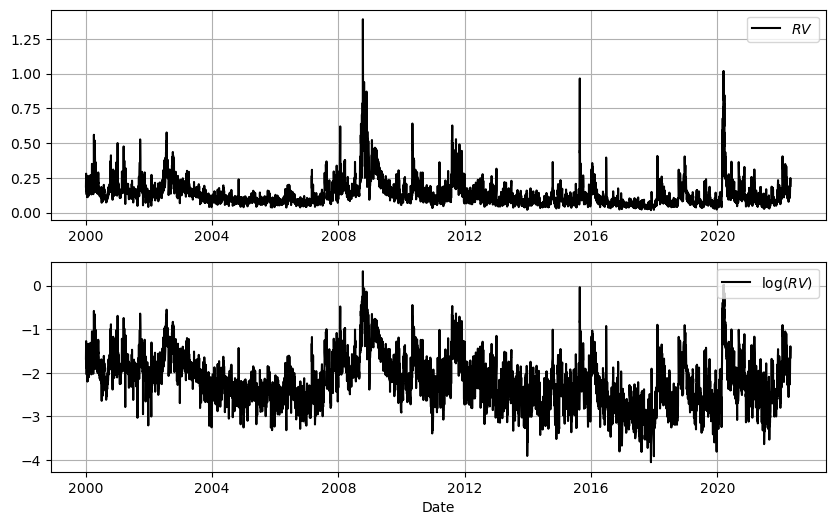

In [8]:
fig, ax = plt.subplots(2, 1, figsize=(10, 6))

ax[0].plot(
    pd.to_datetime(df['Unnamed: 0']), 
    vol_proc,
    'k-',
    label=r"$RV$"
)
ax[0].legend(loc='upper right')
ax[0].grid()

ax[1].plot(
    pd.to_datetime(df['Unnamed: 0']), 
    np.log(vol_proc),
    'k-',
    label=r"$\log(RV)$"
)
ax[1].legend(loc='upper right')
ax[1].grid()
ax[1].set_xlabel("Date")

plt.plot()

### Estimating the smoothness (or roughness?)

Let's consider a trajectory $\sigma_t$ of volatility process. Assuming that its logarithm follows fBM, we can notice that

$$m(q, \Delta) = \dfrac{1}{N}\sum_{k=1}^N \big|\log(\sigma_{k\Delta}) - \log(\sigma_{(k-1)\Delta})\big|^q \approx K_q\Delta^{qH}.$$

Linear regression
$$ \log m(q, \Delta) = b + \zeta_q \log\Delta$$
provides the estimation $\zeta_q$ of the value $qH$.

Doing this calculations for different values of $q$, one finally obtain the estimation of $H$ based on the linear regression
$$\zeta_q = \hat H q.$$

0.11472888801667933

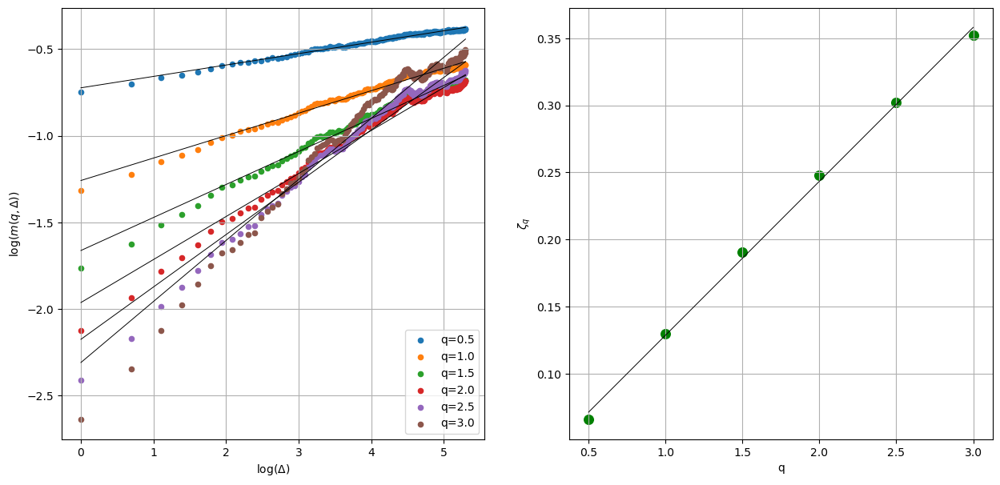

In [9]:
m_estimator(np.log(vol_proc), is_plotting=True, intersect=True, steps=np.arange(1, 201))

In [10]:
fig = px.histogram(x=np.diff(np.log(vol_proc)), histnorm='probability density')

mu, s = np.diff(np.log(vol_proc)).mean(), np.diff(np.log(vol_proc)).std()
x_grid = np.linspace(-1.5, 1.5, 100)

fig.add_scatter(x=x_grid, y=norm.pdf(x_grid, loc=mu, scale=s), mode='lines', name='Normal pdf')

fig.update_layout(height=400, width=600, title_text="Distribution of volatility log-increments")

fig.show()

### Roughness estimates for different market indices

In [11]:
df_full = pd.read_csv('../roughness/data/oxford_man_rv.csv')
tickers = ['.SPX', '.FTSE', '.N225', '.GDAXI', '.RUT']

for ticker in tickers:
    print(ticker)
    df_ticker = df_full.loc[df_full.Symbol == ticker].reset_index(drop=True)
    vol_traj = np.array(np.sqrt(df_ticker.rv5)) * np.sqrt(250) # percent per year
    roughness_report(vol_traj)

.SPX
m-estimator: 0.15185799324120675
.FTSE
m-estimator: 0.10865799222162836
.N225
m-estimator: 0.13432983496904746
.GDAXI
m-estimator: 0.1207591273670392
.RUT
m-estimator: 0.08310745582397558


### Fractional Brownian Motion: a Good Candidate?

In [14]:
H = 0.115
f = FBM(n=4096, hurst=H, length=1, method='daviesharte')
gfBM = np.exp(f.fbm())
fig = px.line(x=f.times(), y=f.fbm())
fig.update_layout(height=400, width=600, title_text=f"Fractional Brownian motion with H={H}")
fig.show()

0.09577462055596199

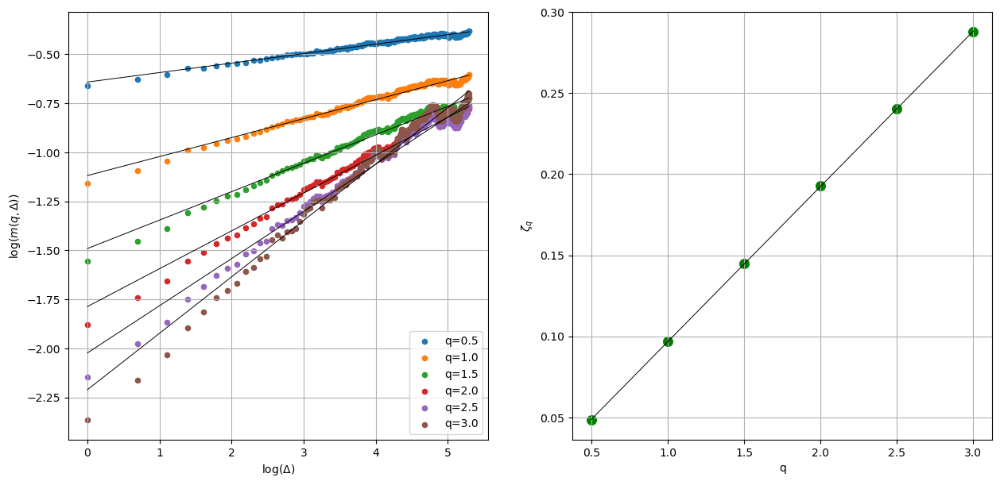

In [15]:
# without intersection
m_estimator(np.log(gfBM), is_plotting=True, intersect=True, steps=np.arange(1, 201))

### Another argument in favor if roughness: ATM skew

By definitiion, at-the-money volatility skew is
$$
\psi(\tau) := \left|\dfrac{\partial}{\partial k}\sigma_{{\rm BS}}(k, \tau)\right|_{k=0}.
$$

#### Non-parametric estimates of the S&P ATM volatility skews and the power-law fit $\psi(\tau) = A\tau^{-0.4}$.

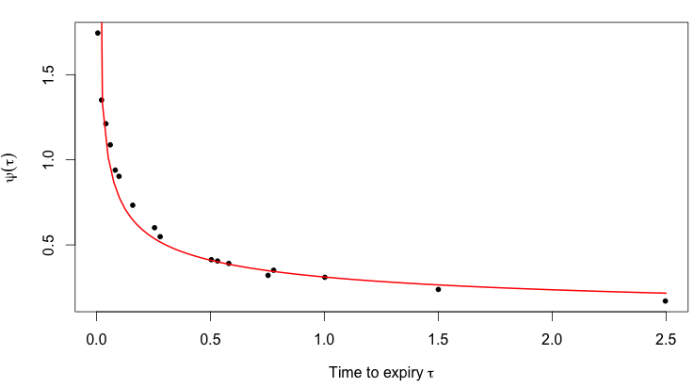

It is known that the volatility driven by the fractional Brownian motion with Hurst exponent $H$ generates an ATM skew of the form $\psi(\tau) \sim \tau^{H-0.5}$.

### Fractional OU model (Gatheral, Jaisson, Rosenbaum)
$$
\begin{cases}
dS_t = \sigma_t S_t\,dW_t,\quad \sigma_t = \sigma_0e^{Y_t}, \\
dY_t = -\lambda Y_t\, dt + \nu\, dB_t^H.
\end{cases}
$$

# Part 3. Volatility is Rough, isn't it? 

### Simulation: gBM volatility process (not a rough guy)

In [18]:
gBM = simulate_gBM(10**6, sigma=1.2) * 0.1
fig = px.line(x=np.linspace(0, 1, gBM.size)[::100], y=gBM[::100])
fig.update_layout(height=400, width=600, title_text="Instantaneous volatility process")
fig.show()

In [19]:
X = price_from_volatility(gBM, x0=97.5)
t = np.linspace(0, 1, X.size)
fig = px.line(x=t[::100], y=X[::100])
fig.update_layout(height=400, width=600, title_text="Price process")
fig.show()

### Realized volatility estimation

Let $\pi$ denote a time grid
$$ 
\pi = \left(0 = t_0 < t_1 < \ldots < t_{N(\pi)}=1\right).
$$

The __realized volatility__ of a price price process $S$ over the interval $[t,\, t+\Delta]$ along the partition $\pi$ is defined as
$$
{\rm RV}_{t,t+\Delta}(\pi) = \sqrt{\sum_{\pi \cap [t,\,t+\Delta]}|X_{t_{i+1}} - X_{t_i}|^2} \approx \sqrt\Delta \sigma_t,
$$
where $X = \log S$.

In [20]:
rv = realized_volatility(X, n_est=150)

In [21]:
fig = make_subplots(rows=2, cols=1)

fig.add_trace(
    go.Scatter(x=np.linspace(0, 1, 10**4), y=rv, name='Realized vol'),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(x=np.linspace(0, 1, 10**6)[::100], y=gBM[::100], name='Instantaneous vol'),
    row=2, col=1
)

fig.update_layout(height=600, width=800, title_text="Realized and instantaneous volatilities")
fig.show()

In [22]:
fig = px.line(x=np.linspace(0, 1, rv.size), y=rv)

fig.update_layout(height=400, width=600, title_text="Volatility process (realized volatility)")
fig.show()

### Normal increments of log-volatility

In [23]:
fig = px.histogram(x=np.diff(np.log(rv)), histnorm='probability density')

mu, s = np.diff(np.log(rv)).mean(), np.diff(np.log(rv)).std()
x_grid = np.linspace(-0.3, 0.3, 100)

fig.add_scatter(x=x_grid, y=norm.pdf(x_grid, loc=mu, scale=s), mode='lines', name='Normal pdf')

fig.update_layout(height=400, width=600, title_text="Distribution of volatility log-increments")

fig.show()

0.15576546835251423

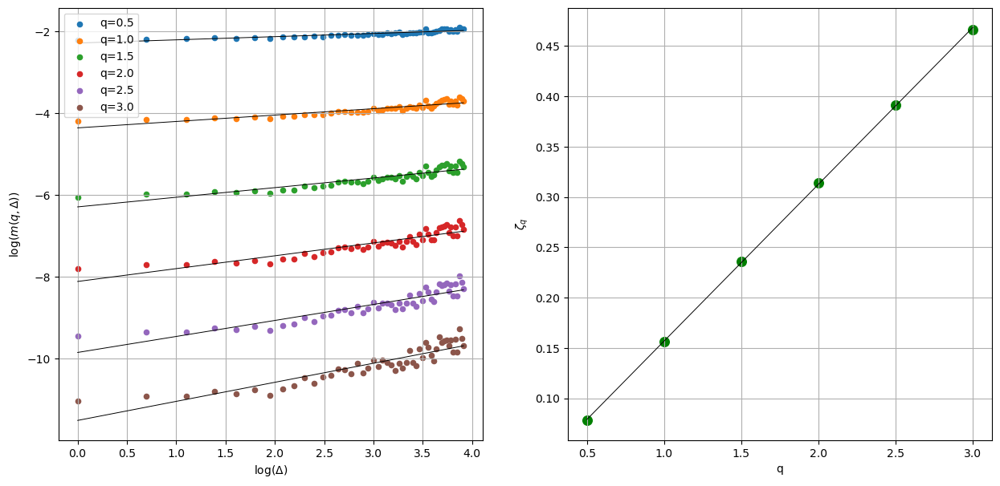

In [24]:
# without intersection
m_estimator(rv, is_plotting=True)

The volatility process was not rough but we obtain $\hat H \approx 0.11$ because of the noise coming from the realized volatility statistical estimation.

## OU Log-volatility (Sampling Frequency Matters)

In [25]:
# parameters initialization
n_days = 5000 * 72
sigma = 0.006
lam = 0.001
init = -1.7
mu = -1.7

In [26]:
OU = simulate_OU(n_sample=n_days,
                 sigma=sigma,
                 lam=lam,
                 T=n_days,
                 mu=mu,
                 init=init)
fig = px.line()
fig.add_scatter(y=OU, name='OU')
# fig.add_scatter(y=np.log(vol_proc), name='Y')

fig.update_layout(height=600, width=800, title_text="OU trajectory")
fig.show()

In [27]:
fig = make_subplots(rows=2, cols=1)

fig.add_trace(
    go.Scatter(x=df['Unnamed: 0'], y=np.exp(OU)[::72], name='exp(OU)'),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(x=df['Unnamed: 0'], y=OU[::72], name='OU'),
    row=2, col=1
)

fig.update_layout(legend=dict(
    orientation="h",
    yanchor="bottom",
    y=1.02,
    xanchor="right",
    x=1
))


fig.update_layout(height=600, width=800)
fig.show()

In [28]:
X = price_from_volatility(np.exp(OU), x0=97.5)
t = np.linspace(0, 1, X.size)
fig = px.line(x=t[::100], y=X[::100])
fig.update_layout(height=400, width=600, title_text="Price process")
fig.show()

In [29]:
rv = realized_volatility(X, n_est=72)

In [30]:
fig = make_subplots(rows=2, cols=1)

fig.add_trace(
    go.Scatter(x=np.linspace(0, 1, 5000), y=np.log(rv), name='Realized vol (log)'),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(x=np.linspace(0, 1, 5000 * 72)[::72], y=OU[::72], name='Instantaneous vol (log)'),
    row=2, col=1
)

fig.update_layout(height=600, width=800, title_text="Realized and instantaneous volatilities")
fig.show()

0.08642466361427463

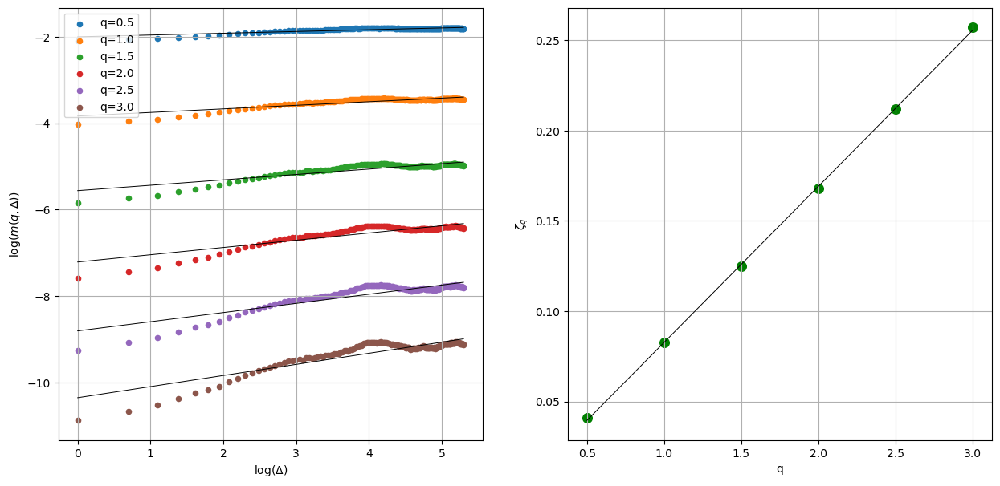

In [31]:
m_estimator(rv, is_plotting=True, intersect=True, steps=np.arange(1, 201))

The process looks like rough due to insufficiently high sampling frequency and fast oscillations. 

### OU-OU model

$$
\begin{cases}
dY_t = \sigma_Y\,dW'_t - \beta Y_t \, dt, \\
dX_t = \sigma_X\,dW_t + \lambda(Y_t - X_t)\,dt
\end{cases}
$$

In [34]:
# parameters initialization
n_days = 5000
sigma_x = 0.3
sigma_y = 0.05
lam_x = 0.3
lam_y = 0.005
init = -7.2
mu = -7.2

#### OU-OU sampling

In [36]:
OUOU, Y = simulate_OUOU(n_sample=n_days,
                        sigma_x=sigma_x,
                        sigma_y=sigma_y,
                        lam=lam_x,
                        beta=lam_y,
                        T=n_days,
                        mu=mu,
                        init=init)
fig = px.line()
fig.add_scatter(y=OUOU, name='OUOU')
fig.add_scatter(y=Y, name='Y')
# fig.add_scatter(y=np.log(vol_proc), name='Y')

fig.update_layout(height=600, width=800, title_text="OU-OU trajectory")
fig.show()

In [37]:
fig = make_subplots(rows=2, cols=1)

fig.add_trace(
    go.Scatter(x=df['Unnamed: 0'], y=np.exp(OUOU), name='exp(OUOU)'),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(x=df['Unnamed: 0'], y=OUOU, name='OUOU'),
    row=2, col=1
)
fig.add_trace(
    go.Scatter(x=df['Unnamed: 0'], y=Y, name='Y'),
    row=2, col=1
)

fig.update_layout(legend=dict(
    orientation="h",
    yanchor="bottom",
    y=1.02,
    xanchor="right",
    x=1
))


fig.update_layout(height=600, width=800)
fig.show()

0.1320524232979018

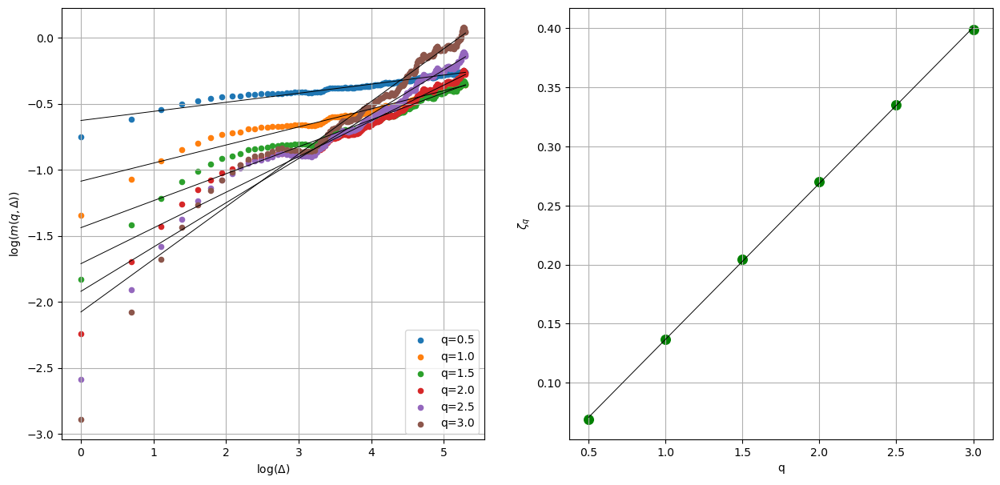

In [38]:
m_estimator(OUOU, is_plotting=True, intersect=True, steps=np.arange(1, 201))